## Skeleton of SDAP client benchmarking MSLSP algorithm requests

The notebook is extracting 2 years time series of every pixel of tile T18TYN

# Import

In [2]:
%matplotlib inline
import mpld3
mpld3.enable_notebook()
import numpy as np
import requests
import ray
import time
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter, YearLocator
from datetime import datetime
from multiprocessing import Pool
from functools import partial

### Ray.io initialization.

The ray call are not used yet but will be to ditribute the chunk processing. The current algorithm is only pulling one chunk in parallel on a single node.

In [3]:
ray.init(ignore_reinit_error=True)
# can use that to work with the JPL VPN on, don't know what to put as address though...
# ray.init(node_ip_address='…')

2021-07-20 15:29:19,591	INFO services.py:1269 -- View the Ray dashboard at http://127.0.0.1:8266


{'node_ip_address': '192.168.1.165',
 'raylet_ip_address': '192.168.1.165',
 'redis_address': '192.168.1.165:27046',
 'object_store_address': '/tmp/ray/session_2021-07-20_15-29-17_459621_54814/sockets/plasma_store',
 'raylet_socket_name': '/tmp/ray/session_2021-07-20_15-29-17_459621_54814/sockets/raylet',
 'webui_url': '127.0.0.1:8266',
 'session_dir': '/tmp/ray/session_2021-07-20_15-29-17_459621_54814',
 'metrics_export_port': 64035,
 'node_id': 'f830668a8eaf1dc276986477bb2551aad1701caec87f547e09360759'}

### Identify the range on which we want to work

In [4]:
lat_range = [43.3261171080151, 42.302597437408]
lon_range = [-72.5725144474117, -71.1820663001426]

### Timeseries individual request (ie for one grid chunk)

In [125]:
def lat_lon2hash5(lat, lon):
    return f'{lat:0.5f}_{lon:0.5f}'

def hash52lat_lon(hash):
 lat_lon = hash.split('_')
 return float(lat_lon[0]), float(lat_lon[1])


def extract_time_series(sdap_response, multi_band=True):
    time_series = {}
   
    # assemble time series per location
    for p in sdap_response['data']:
        hash5 = lat_lon2hash5(p['latitude'], p['longitude'])
        if not hash5 in time_series.keys():
            time_series[hash5] = []
        
        if multi_band:
            measurement = {'time': datetime.fromtimestamp(p['time']), 
                                       'mb_vector': p['data'][0]['variable'],
                                       'evi': p['data'][0]['evi']
                                      }
        else:
            measurement = {'time': datetime.fromtimestamp(p['time']), 
                                       'variable': p['data'][0]['variable'],
                                      }
            
        time_series[hash5].append(measurement)
    
    if multi_band:
        if 'var_name' in sdap_response['meta']:
            mb_vars = eval(sdap_response['meta']['var_name']) # the array is a string because of backward compatibility with mono band datasets
        else:
            return None
    
    # sort time series & transpose to plot easily  
    for k, ts in time_series.items():
        ts.sort(key=lambda x: x['time'])
        variable = 'evi' if multi_band else 'variable'
        ts_transp = {'t': [v['time'] for v in ts],
              variable:[v[variable] for v in ts],
            }
        
        # add multiband data
        if multi_band:
            i = 0
            for var in mb_vars:
               ts_transp[var] = [v['mb_vector'][i] for v in ts]
               i+=1
        
        time_series[k] = ts_transp
    
    return time_series
        


def getTimeSeries(
        lat_min,
        lon_min,
        lat_max,
        lon_max,
        start_time=datetime(2016, 7, 1),
        end_time=datetime(2018, 6, 30),
        base_url="https://oceanworks.jpl.nasa.gov", 
        dataset="HLS.L30.T18TYN",
        multi_band=True
        
    ):

    # ISO-8601 date format
    dt_format = "%Y-%m-%dT%H:%M:%SZ"

    #try:
    url = '{}/datainboundsmb?ds={}&b={},{},{},{}&startTime={}&endTime={}'.\
        format(base_url, dataset, lon_min , lat_min, lon_max, lat_max,
               start_time.strftime(dt_format), end_time.strftime(dt_format))
    #print(url)
    #session = requests.Session()
    response = requests.get(url)
    #print(response)
    if response.status_code == 200:
        sdap_response = response.json()
        ts = extract_time_series(sdap_response, multi_band=multi_band)
        return ts
    else:
        return None


def phenology_place_holder(ts):
    ## simple mean and count 
    means = {}
    for key, loc_ts in ts.items():
        means[key] = {}
        for var, values in loc_ts.items():
            if var!='t':
                means[key][var] = np.mean([val for val in values if val])
        means[key]['meas_count'] = len(loc_ts['t'])
            
    return means


@ray.remote
def get_ts_mb_distributed(lat_min, lon_min, lat_max, lon_max):
    return getTimeSeries(
        lat_min, lon_min, lat_max, lon_max,
        start_time=datetime(2017, 1, 1),
        end_time=datetime(2019, 12, 31),
        base_url="https://oceanworks.jpl.nasa.gov",
        dataset="hls.preprocessed-m2-01",
        multi_band=True)

@ray.remote
def get_and_process_ts_mb_distributed(lat_min, lon_min, lat_max, lon_max):
    ts = getTimeSeries(
        lat_min, lon_min, lat_max, lon_max,
        start_time=datetime(2017, 1, 1),
        end_time=datetime(2019, 12, 31),
        base_url="https://oceanworks.jpl.nasa.gov",
        dataset="hls.preprocessed-m2-01",
        multi_band=True)
    if ts:
        return phenology_place_holder(ts)
    else:
        return None






### List the pixel chunks (bbox)

Here only the first 2


In [101]:
bboxes = []
number_of_chunk_square_root = 200
lat_edge = (lat_range[1]-lat_range[0])/number_of_chunk_square_root
lon_edge = (lon_range[1]-lon_range[0])/number_of_chunk_square_root
i = 0
for lat in np.arange(lat_range[0], lat_range[1], lat_edge):
    bboxes.append([])
    for lon in np.arange(lon_range[0], lon_range[1], lon_edge):   
        bboxes[i].append([
            lat, 
            lon,
            lat + lat_edge,
            lon + lon_edge
        ])
    i+=1
                        

In [102]:
len(bboxes)

200

In [90]:
def plot_time_series(time_series, var):
    
    _, ax = plt.subplots()
    
    for ts in time_series.values():
        if ts:
            ax.plot(ts['t'], ts[var])

    ax.xaxis.set_major_locator(YearLocator())
    ax.xaxis.set_major_formatter(DateFormatter('%Y'))
    ax.set_ylabel(f'{var} preprocessed') 


### Launch the extraction

For 32 timeseries in parallel (8).

(pid=55252) https://oceanworks.jpl.nasa.gov/datainboundsmb?ds=hls.preprocessed-m2-01&b=-71.80004325448435,43.18396159820855,-71.76141969483798,43.15553049624724&startTime=2017-01-01T00:00:00Z&endTime=2019-12-31T00:00:00Z
(pid=55252) .
(pid=55252) <Response [200]>
130.79190611839294 seconds


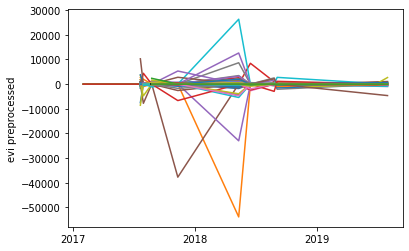

In [9]:
t_start = time.time()

time_series = ray.get(get_ts_mb_distributed.remote(*bboxes[200]))
plot_time_series(time_series, 'evi')

duration = time.time() - t_start
print(f'{duration} seconds')

In [10]:
len(time_series.keys())

10243

In [109]:
t_start = time.time()

chunk_means = ray.get([get_and_process_ts_mb_distributed.remote(*bbox) for bboxes_line in bboxes[40:50] for bbox in bboxes_line[40:50]])

duration = time.time() - t_start
print(f'{duration} seconds')

2021-07-20 18:40:55,981	ERROR worker.py:1056 -- Possible unhandled error from worker: ray::get_and_process_ts_mb_distributed() (pid=55266, ip=192.168.1.165)
  File "python/ray/_raylet.pyx", line 505, in ray._raylet.execute_task
  File "<ipython-input-92-3419c2eff997>", line 117, in get_and_process_ts_mb_distributed
  File "<ipython-input-92-3419c2eff997>", line 81, in getTimeSeries
  File "/Users/loubrieu/opt/anaconda3/lib/python3.7/site-packages/requests/models.py", line 898, in json
    return complexjson.loads(self.text, **kwargs)
  File "/Users/loubrieu/opt/anaconda3/lib/python3.7/json/__init__.py", line 348, in loads
    return _default_decoder.decode(s)
  File "/Users/loubrieu/opt/anaconda3/lib/python3.7/json/decoder.py", line 337, in decode
    obj, end = self.raw_decode(s, idx=_w(s, 0).end())
  File "/Users/loubrieu/opt/anaconda3/lib/python3.7/json/decoder.py", line 355, in raw_decode
    raise JSONDecodeError("Expecting value", s, err.value) from None
json.decoder.JSONDecodeEr

5649.582192897797 seconds


In [110]:
means = {}
for chunck_mean in chunk_means:
    if chunck_mean:
        means.update(chunck_mean)

In [111]:
len(means.keys())



33136

In [112]:

grid_points = []
measurements = {}
for k, values in means.items():
    lat, lon = hash52lat_lon(k)
    grid_points.append([lat, lon]) 
    for var, value in values.items():
        if var not in measurements:
            measurements[var] = []
        measurements[var].append(value)
    

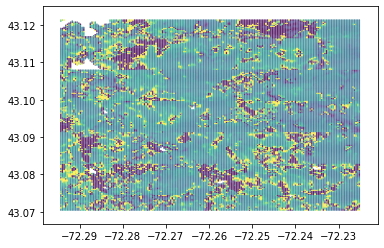

In [116]:
lat_lon = np.transpose(grid_points)
plt.scatter(lat_lon[1], lat_lon[0], s=0.2, c=measurements['evi'], vmin=-3, vmax=3)

 

In [117]:
lats = sorted(np.unique(lat_lon[0]))
lons = sorted(np.unique(lat_lon[1]))

var_matrices = {}
i = 0
for lat in lats:
    j = 0
    for lon in lons:
        hash5 = lat_lon2hash5(lat,lon)
        if hash5 in means:
            for var, value in means[hash5].items():
                if var not in var_matrices:
                    var_matrices[var] = np.empty([len(lats), len(lons)])
                    var_matrices[var][:] = np.NaN
                var_matrices[var][i, j] = value
        j+=1
    i+=1
    



In [126]:
var_matrices.keys()


dict_keys(['evi', 'b2', 'b3', 'b4', 'b5', 'b6', 'b7', 'meas_count'])

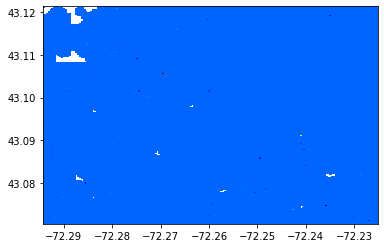

In [129]:

plt.pcolormesh(lons, lats, var_matrices['evi'], cmap='jet')

In [50]:
np.arange(-3, 3, 20)

array([-3])

In [183]:
sorted(evi_points[1])

[-72.53490572156562,
 -72.53490467801427,
 -72.53490363441416,
 -72.53490259076533,
 -72.53490154706775,
 -72.53490050332145,
 -72.53489945952643,
 -72.53489841568266,
 -72.53489773543879,
 -72.5348966914942,
 -72.5348954909316,
 -72.53489444753406,
 -72.53452559955355,
 -72.5345254141442,
 -72.53452522027494,
 -72.53452455785029,
 -72.53452417986153,
 -72.53452351609828,
 -72.53452313939934,
 -72.5345224742975,
 -72.53452246270248,
 -72.53452143244799,
 -72.53452142213938,
 -72.53452039054969,
 -72.53452038152751,
 -72.53451934860263,
 -72.53451934086686,
 -72.53451914244953,
 -72.53451830660684,
 -72.53451830015746,
 -72.53451810238512,
 -72.53451726456228,
 -72.5345172593993,
 -72.53451706227193,
 -72.53451658617733,
 -72.53451621859234,
 -72.53451602210998,
 -72.53451554403188,
 -72.53451517773665,
 -72.53451498189926,
 -72.53451450183766,
 -72.53451413683219,
 -72.53451394163977,
 -72.5341459897583,
 -72.53414585958373,
 -72.53414566969226,
 -72.53414547039256,
 -72.53414526263012

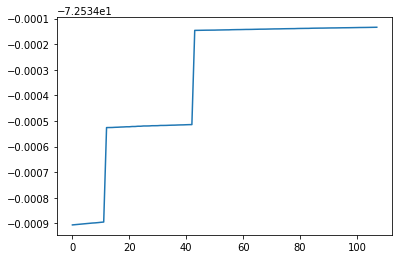

In [182]:
plt.plot(sorted(evi_points[1]))